In [1]:
import numpy as np
import pandas as pd
from scipy.stats import laplace
import scipy.stats
import psycopg2
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from datetime import datetime
from datetime import timedelta  
import threading
import os

In [2]:
param_dic = {
    "host"      : "localhost",
    "database"  : "bachelorBesoeg2014",
    "user"      : "postgres",
    "password"  : "password",
    "port"      : "5432"
}

def execRangeQuery(params_dic,dates):
    query = """
    SELECT
    sum(count_)
    FROM _775147
    WHERE
    time_ >= '{date0}'
    AND time_ <=  '{date1}'
    ;
    """.format(date0 = dates[0], date1 = dates[1])
    try:
        connection = psycopg2.connect(**params_dic)
        cursor = connection.cursor()
        cursor.execute(query)
        record = cursor.fetchall()
        return record
    except (Exception, psycopg2.Error) as error :
        connection = False
        print ("Error while connecting to PostgreSQL", error)
    finally:
        if(connection):
            cursor.close()
            connection.close()
            print("Executed query and closed connection.")

def execQuery(params_dic,query):
    try:
        connection = psycopg2.connect(**params_dic)
        cursor = connection.cursor()
        cursor.execute(query)
        record = cursor.fetchall()
        return record
    except (Exception, psycopg2.Error) as error :
        connection = False
        print ("Error while connecting to PostgreSQL", error)
    finally:
        if(connection):
            cursor.close()
            connection.close()
            print("Executed query and closed connection.")
#"""select count(*) as number_of_dates, count(DISTINCT  count_) as distinct_count from _775147;"""
query = """select time_ from _775147;"""
result = execQuery(param_dic, query)
dates = [(date[0]) for date in result]

query = """select count_ from _775147;"""
result = execQuery(param_dic, query)
"""
print(result)
print(type(result))
print(type(result[0]))
print((str(result[0][0])))
"""
counts = [(count[0]) for count in result]

Executed query and closed connection.
Executed query and closed connection.


In [3]:
def add_missing_dates(old_dates):
    start_date = dates[0]
    end_date = dates[-1]
    all_dates = pd.date_range(start = start_date, end = end_date).to_pydatetime().tolist()
    return [(date.date()) for date in all_dates]
    
def add_missing_counts(old_counts, old_dates, new_dates):
        """Adds 0 to the list of counts where there was missing dates
        Parameters:
        old_counts (list of int): List counts for each day with 
        old_dates (list of datetime.date): List of dates that is not countious
        Returns:
        List of countious starting with the first value of 
        """
        zip_iterator = zip(old_dates, old_counts)
        missing_dict =  dict(zip_iterator)
        all_counts = np.zeros(len(new_dates))
        for i, date in enumerate(new_dates):
            val = missing_dict.get(date, 0)
            all_counts[i] = val
            
        return all_counts

In [4]:
all_dates = add_missing_dates(dates)
all_counts =  add_missing_counts(counts, dates, all_dates)

In [5]:
def plot_estimates_flat(number_of_queries, N, model, epsilon, dates, counts, range_qurey, plot_name):
    
    test_dates, test_counts = dates[:N].copy(), counts[:N].copy()
    answers = np.zeros(number_of_queries)
    

    for i in range(0,number_of_queries):
        current_model = model(epsilon, test_dates, test_counts)
        answer = current_model.answer(range_qurey)
        answers[i] = answer
    print(answers)
    correct_answer = current_model.real_answer(range_qurey)
    
    x = np.arange(0,number_of_queries)
    answers.sort()

    plt.scatter(x,answers, marker = '+', label="Esitmates")
    plt.axhline(np.mean(answers),linewidth=0.5, color='r', linestyle = '-', label="Mean of esitmates ")
    plt.axhline(correct_answer,linewidth=.4, color='b', linestyle = '--', label="Correct answer")
    #plt.hlines(np.mean(answears128),line_range[0],line_range[1])
    #plt.hlines(np.mean(correct_answear),line_range[0],line_range[1])
    plt.legend()
    plt.title(f'Local HH OLH with N = {N} and \u03B5 = {epsilon}')
    plt.savefig(plot_name)
    plt.show()
    return answers

In [6]:
def plot_estimates_hh_degree(number_of_queries, N, model, epsilon, degree, dates, counts, range_qurey, plot_name):
    
    test_dates, test_counts = dates[:N].copy(), counts[:N].copy()
    answers = np.zeros(number_of_queries)
    

    for i in range(0,number_of_queries):
        current_model = model(epsilon, degree, test_dates, test_counts)
        answer = current_model.answer(range_qurey)
        answers[i] = answer
    print(answers)
    correct_answer = current_model.real_answer(range_qurey)
    
    x = np.arange(0,number_of_queries)
    answers.sort()

    plt.scatter(x,answers, marker = '+', label="Esitmates")
    plt.axhline(np.mean(answers),linewidth=0.5, color='r', linestyle = '-', label="Mean of esitmates ")
    plt.axhline(correct_answer,linewidth=.4, color='b', linestyle = '--', label="Correct answer")
    #plt.hlines(np.mean(answears128),line_range[0],line_range[1])
    #plt.hlines(np.mean(correct_answear),line_range[0],line_range[1])
    plt.legend()
    plt.title(f'Local HH OLH with N = {N}, B = {degree} and \u03B5 = {epsilon}')
    plt.savefig(plot_name)
    plt.show()
    return answers

In [7]:
def plot_estimates_hh_degree_mutiplee_qurries(queries, N, model, epsilon, degree, dates, counts):
    
    test_dates, test_counts = dates[:N].copy(), counts[:N].copy()
    answers = np.zeros(len(queries))
    
    current_model = model(epsilon, degree, test_dates, test_counts)
    correct_answers = np.zeros(len(queries))

    for i in range(0, len(queries)):
        answer = current_model.answer(queries[0])
        answers[i] = answer
        correct_answers[i] = current_model.real_answer(queries[0])
    
    return answers, correct_answers

-2289.4113281886466
[60149.]
1
[31778. 28075.     0.     0.]
4
[8188. 8665. 8322. 8396. 8594. 8270. 8256. 1558.    0.    0.    0.    0.
    0.    0.    0.    0.]
16
[1877. 1906. 1987. 1958. 1982. 1932. 1979. 1897. 1998. 1857. 1964. 1925.
 2017. 1929. 1956. 1906. 1863. 1827. 2140. 1940. 1952. 1915. 1993. 1969.
 1891. 1968. 1918. 1878. 1918. 1981. 1863.   41.    0.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.    0.    0.]
64
[460. 476. 499. 518. 445. 514. 421. 502. 484. 485. 460. 453. 466. 475.
 452. 469. 458. 492. 485. 475. 496. 489. 518. 498. 468. 496. 477. 490.
 466. 499. 441. 463. 448. 463. 459. 482. 465. 456. 510. 474. 464. 449.
 500. 472. 472. 465. 489. 469. 472. 478. 518. 504. 447. 472. 478. 485.
 447. 463. 458. 484. 415. 482. 452. 500. 447. 488. 477. 439. 460. 479.
 473. 467. 475. 527. 451. 478. 504. 474. 491. 538. 492. 476. 463. 467.
 469. 535. 495.

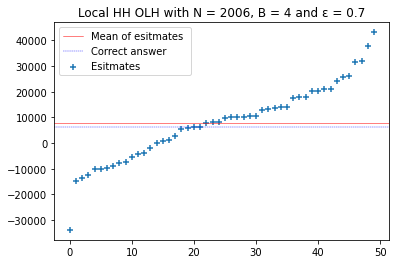

'\na\n'

In [70]:
class HH_OLH_degree:
    def __init__(self, epsilon, degree, dates, counts):
        """Setup of the datastructere
        Parameters:
        T (int): The lenght of the stream
        epsilon (float): The height of the full binary tree. 
        dates (Array): The dates of the stream
        counts (Array): The count for each of the dates
        Returns:
        A epsilon differintial datastructe
        """
        self.epsilon = epsilon
        self.all_dates = dates
        self.all_counts = counts
        #Check if we are we have missing dates.
        if len(dates) < (dates[-1]-dates[0]).days:
            #print('here')
            self.all_dates = self.__add_missing_dates(dates)
            self.all_counts = self.__add_missing_counts(counts,dates)
            
        #Make dict for date indexing
        values = np.arange(0,len(self.all_dates))
        zip_iterator = zip(self.all_dates, values)
        self.idx_dict =  dict(zip_iterator)
     
        self.degree = degree
        self.h = int(np.ceil(np.log(len(self.all_dates)) / np.log(degree)))
        self.level_prob = np.full(self.h+1,1/(self.h+1))
    
        self.max_val = np.max(np.fromiter(self.idx_dict.values(), dtype = int))
        self.max_idxs = (self.get_index(self.max_val,self.h))
        self.max_idxs.reverse()
        
        self.tree_levels = self.__process(self.all_dates, self.all_counts)
        
        
        
    def __add_missing_dates(self, old_dates):
        """Add missing dates in a list
        Parameters:
        old_dates (list of datetime.date): List of dates that is not countious
        Returns:
        List of countious starting with the first value of 
        """
        start_date = dates[0]
        end_date = dates[-1]
        all_dates = pd.date_range(start = start_date, end = end_date).to_pydatetime().tolist()
        return [(date.date()) for date in all_dates]
    
    def __add_missing_counts(self, old_counts, old_dates):
        """Adds 0 to the list of counts where there was missing dates
        Parameters:
        old_counts (list of int): List counts for each day with 
        old_dates (list of datetime.date): List of dates that is not countious
        Returns:
        List of countious starting with the first value of 
        """
        zip_iterator = zip(old_dates, old_counts)
        missing_dict =  dict(zip_iterator)
        all_counts = np.zeros(len(self.dates))
        for i, date in enumerate(self.dates):
            val = missing_dict.get(date, 0)
            all_counts[i] = val
            
        return all_counts
    
    def __process(self, dates, counts):
        tree_levels = []
        for i in np.arange(0,self.h+1):
            level = np.zeros(int(self.degree**np.ceil(i)))
            tree_levels.append(level)
        
        for index, (date, day_count) in enumerate(zip(dates, counts)):
            idxs = self.get_index(index,self.h)
            idxs.reverse()
            #print(self.max_idxs)
            for person in range(int(day_count)):
                level = np.random.choice(np.arange(0, self.h+1), p = self.level_prob ) 
        
                if level != 0:
                    """
                    print(f' We are at level {level}')
                    print(f' max index at level is {self.max_idxs[level]}')
                    print(f'Now we hash down to {(self.degree**level)}')
                    """
                    hash_value = self.max_idxs[level]
                    response = self.OLH_func(idxs[level], hash_value)
                    
                else:
                    response = 0
                tree_levels[level][response] = tree_levels[level][response] + 1

        return tree_levels

    def get_index(self, date_idx, n_layers):
        """Calculates the path of index in full binary string

        Parameters:
        date_idx (int): The node in the bouttom layer we want to calculate a path to. 
        The bottom layer has index from 0 to 2**h-1
        n_layers (int): The height of the full binary tree. 

        Returns:
        list: of index in the path from the starting from the bottom and going up

        """
        idx = []
        for i in np.arange(0,n_layers):
            if i == 0:
                idx.append(int(date_idx))
            else:
                idx.append(int(idx[i-1]//self.degree))
        idx.append(0)
        return idx
    
    def get_group(self, idx, level):
        """Calculates the path of index in full binary string

        Parameters:
        date_idx (int): The node in the bouttom layer we want to calculate a path to. 
        The bottom layer has index from 0 to 2**h-1
        n_layers (int): The height of the full binary tree. 0 index

        Returns:
        list: of index in the path from the starting from the bottom and going up

        """
        if level == 0:
            return id
        elif idx == 0:
            return np.arange(0,self.degree)
        else:
            group_index = idx //self.degree
            level_indicis = np.arange(0,self.degree**level)

            split_ratio = (len(level_indicis) // self.degree)
            level_indicis_split = np.array_split(level_indicis, split_ratio)
            
            return level_indicis_split[group_index]
    
    def OLH_func(self, x, g):
        if np.random.uniform(0,1) < np.exp(self.epsilon)/(np.exp(self.epsilon)+g-1):
            return x
        else:
            return np.random.randint(low = 0, high = g)
    
    def OLH_aggre(self, count, N, g):
        p = np.exp(self.epsilon)/(np.exp(self.epsilon)+g-1)
        #print(p - 1/g)
        #print(f'p = {p}')
        return (count - (1-p)*N/g) / (p)
    
    def turns_right(self, path):
        #0 is left 1 is right
        direction_lst = []
        for i in range(len(path)-1):
            current = path[i]
            nxt = path[i+1]
            if nxt == 0:
                #We went left
                direction_lst.append(0)
            elif current == 0 and current < nxt:
                #We went right
                direction_lst.append(1)
            elif self.degree * current < nxt:
                #We went right
                direction_lst.append(1)
            else:
                #print('else')            
                direction_lst.append(0)

        return direction_lst

    def turns_left(self, path):
        #0 is left 1 is right
        direction_lst = []
        for i in range(len(path)-1):
            current = path[i]
            nxt = path[i+1]
            #Checks
            if nxt == 0:
                #We went left
                direction_lst.append(0)
            #Checks
            elif nxt == current*self.degree + self.degree - 1:
                #We went right
                direction_lst.append(1)
            elif current == 0 and current < nxt:
                #We went left
                direction_lst.append(0)
            else:
                direction_lst.append(0)

        return direction_lst
    
    def answer(self, dates):
        """Calculates the path of index in full binary string

        Parameters:
        dates (tuple of string): Two dates in the format string 2000-12-19. 

        Returns:
        float: The private range count
        """
            
        date_obj_0 = datetime.strptime(dates[0],'%Y-%m-%d').date()
        date_obj_1 = datetime.strptime(dates[1],'%Y-%m-%d').date()


        idx_0 = self.idx_dict[date_obj_0]
        idx_1 = self.idx_dict[date_obj_1]
        
        #print(idx_0)
        #print(idx_1)
        idx_left = idx_0-1
        idx_right = idx_1+1
        
        path_to_left = np.flip(np.array(self.get_index(idx_left,self.h)))
        path_to_right = np.flip(np.array(self.get_index(idx_right,self.h)))
        
        left_or_right_list_leftside = self.turns_left(path_to_left)
        left_or_right_list_rightside = self.turns_right(path_to_right)
        
        range_count = 0.0
        
        #Starting in 0
        if idx_0 == 0:
            level_offset = 1

            for i in range(len(left_or_right_list_rightside)):
                if left_or_right_list_rightside[i] == 1:
                    group = self.get_group(path_to_right[i+level_offset], i+level_offset)
                    idx_sss = np.where(group == path_to_right[i+level_offset])[0][0]

                    count_nodes = self.tree_levels[i+level_offset][group[:idx_sss]]
                    hash_value = self.max_idxs[i+level_offset]
                    
                    for node in count_nodes:
                        range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)
    
        elif idx_1 == np.max(np.fromiter(self.idx_dict.values(), dtype = int)):
            
            level_offset = 1

            for i in range(len(left_or_right_list_leftside)):
                if left_or_right_list_leftside[i] == 0:

                    group = self.get_group(path_to_left[i+level_offset], i+level_offset)
                    idx_sss = np.where(group == path_to_left[i+level_offset])[0][0]

                    count_nodes = self.tree_levels[i+level_offset][group[idx_sss+1:]]
                    
                    hash_value = self.max_idxs[i+level_offset]
                    for node in count_nodes:
                        #print(node)
                        
                        range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)
                    
                    
        else:
            level_offset = 1
            left_count = []
            left_count_group = []

            for i in range(len(left_or_right_list_rightside)):
                if left_or_right_list_rightside[i] == 1:
                    group = self.get_group(path_to_right[i+level_offset], i+level_offset)
                    idx_sss = np.where(group == path_to_right[i+level_offset])[0][0]

                    left_count_group.append(group[:idx_sss]) 

                    count_nodes = self.tree_levels[i+level_offset][group[:idx_sss]]
                    left_count.append(count_nodes)

                else:
                    left_count_group.append(np.array([]))
                    left_count.append(np.array([]))

            #The search right side
            right_count = []
            right_count_group = []

            for i in range(len(left_or_right_list_leftside)):
                if left_or_right_list_leftside[i] == 0:

                    group = self.get_group(path_to_left[i+level_offset], i+level_offset)
                    idx_sss = np.where(group == path_to_left[i+level_offset])[0][0]

                    right_count_group.append(group[idx_sss+1:]) 

                    count_nodes = self.tree_levels[i+level_offset][group[idx_sss+1:]]
                    right_count.append(count_nodes)

                else:
                    right_count_group.append(np.array([]))
                    right_count.append(np.array([]))

            for i in range(len(left_count_group)):
                
                hash_value = self.max_idxs[i + level_offset]
                if left_count_group[i].size != 0 and right_count_group[i].size != 0:
                    #Both not zero
                    group_left = self.get_group(left_count_group[i][0], i+ level_offset)
                    group_right = self.get_group(right_count_group[i][0], i+ level_offset)

                    if not (np.array_equal(group_left,group_right)):
                        for node in left_count_group[i]:
                            range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)
                        for node in right_count_group[i]:
                            range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)
                    else:
                        count_nodes = np.intersect1d(left_count_group[i], right_count_group[i])
                        for node in count_nodes:
                            range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)

                if left_count_group[i].size != 0 and right_count_group[i].size == 0:
                    #Left not zero
                    for node in left_count_group[i]:
                        range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)

                if right_count_group[i].size != 0 and left_count_group[i].size == 0:
                    #Right not zero
                    for node in right_count_group[i]:

                        range_count = range_count + self.OLH_aggre(node, np.sum(self.tree_levels[i+level_offset]), hash_value)
        #Correct for sampling differnt levels in the tree               
        return range_count * (self.h+1)
    
    def real_answer(self, dates):
        if len(dates) < 2:
            date_obj_0 = datetime.strptime(dates[0],'%Y-%m-%d').date()
            return self.all_counts[self.idx_dict[date_obj_0]]
        else:
            date_obj_0 = datetime.strptime(dates[0],'%Y-%m-%d').date()
            date_obj_1 = datetime.strptime(dates[1],'%Y-%m-%d').date()
            sum_ = np.sum(self.all_counts[self.idx_dict[date_obj_0]: self.idx_dict[date_obj_1]+1])  
            return sum_ 

query_dates = ('2014-1-2','2014-2-2')
epsilon = 0.7
degree = 4
local_HH = HH_OLH_degree(epsilon, degree, all_dates[:], all_counts[:])
print(local_HH.answer(query_dates))

for level in local_HH.tree_levels:
    print(level)
    print(len(level))
    
number_of_queries = 50 
N = len(all_dates)
plot_estimates_hh_degree(number_of_queries, N, HH_OLH_degree, epsilon, degree, all_dates, all_counts, query_dates, '1234.png')
"""
a
"""

In [ ]:
def max_index 

In [16]:
a = local_HH.idx_dict.values()
max_val = np.max(np.fromiter(local_HH.idx_dict.values(), dtype = int))
print(max_val)

2005


In [48]:
max_idxs = (local_HH.get_index(max_val,local_HH.h))
max_idxs.reverse()

In [49]:
print(max_idxs)

[0, 1, 7, 31, 125, 501, 2005]


In [50]:
def process(dates, counts):
        tree_levels = []
        for i in np.arange(0,local_HH.h+1):
            level = np.zeros(int(local_HH.degree**np.ceil(i)))
            tree_levels.append(level)
        
        for index, (date, day_count) in enumerate(zip(dates, counts)):
            idxs = local_HH.get_index(index,local_HH.h)
            idxs.reverse()
            for person in range(int(day_count)):
                level = np.random.choice(np.arange(0, local_HH.h+1), p = local_HH.level_prob ) 
                
                if level != 0:
                    print(f' We are at level {level}')
                    print(f' max index at level is {max_idsx[level]}')
                    print(f'Now we hash down to {(local_HH.degree**level)}')
                    hash_value = max_idxs[level]
                    response = local_HH.OLH_func(idxs[level], hash_value)
                else:
                    response = 0
                tree_levels[level][response] = tree_levels[level][response] + 1

        return tree_levels

In [46]:
test_levels = process(all_dates[:], all_counts[:])

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 ma

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at leve

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now

Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level i

 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we h

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 ma

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max ind

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we

Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We a

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at le

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at

Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash d

 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we h

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005

 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7


 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 ma

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level i

Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We ar

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index 

 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
No

 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 10

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is

 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we h

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 

Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at 

Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at le

 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
No

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 50

 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now w

 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at 

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at l

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1


 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
N

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 5

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level

Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at leve

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at lev

 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level 

Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at leve

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index a

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at l

Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We 

 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash do

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31


 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max inde

 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level i

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now 

 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
N

Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 

 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 

 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 20

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at le

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at leve

 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at lev

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now w

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level 

Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level i

 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash dow

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down 

 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501


 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max ind

Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at leve

Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at le

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index

 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we h

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31


 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 ma

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 W

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
No

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now

Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We a

 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we 

Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at

 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1


 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at lev

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at lev

 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
N

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level i

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005


 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we h

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 200

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max inde

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now w

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at le

Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to

Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 409

 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now w

 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at leve

 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now

 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash do

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4

 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 10

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index a

 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at leve

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at lev

Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index 

 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7


Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index 

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is

 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
No

 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we h

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
N

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at le

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we 

 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now w

Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at l

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we 

 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max in

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down 

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index

Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index a

Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at lev

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at leve

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at le

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 50

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now w

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level i

Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at le

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level

 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024


 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now w

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at lev

Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at leve

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at l

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at leve

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 3

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max inde

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 ma

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at leve

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max ind

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at lev

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max ind

 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down t

Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 W

Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We ar

 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at leve

Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at leve

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index a

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max ind

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 12

Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096


Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We 

Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at 

 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we has

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at l

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level i

Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at lev

Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at le

Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3


 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash dow

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max in

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index

 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down t

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at leve

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at 

Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at lev

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at le

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at le

Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
N

Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1


 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3


Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are

 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
No

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max i

 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now w

 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down t

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index 

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index a

 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
N

 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we has

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level

 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we ha

Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We ar

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at lev

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at le

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level i

Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max

 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down 

 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 ma

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at le

Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 m

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 m

Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
No

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at lev

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max inde

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at l

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level i

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 m

 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 2

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at leve

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now 

 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 40

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
No

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at lev

 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
N

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005


 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash 

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max ind

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at leve

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at lev

 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
N

Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256


 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at lev

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is

Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 ma

Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at le

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at l

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index a

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index 

Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are 

 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at lev

 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at lev

Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at le

 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at 

Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We

 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down 

Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 W

 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we 

Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We ar

Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at l

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max ind

 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we ha

Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at l

 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at leve

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at l

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max ind

Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at lev

Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at leve

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at l

 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16


 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we has

 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now w

 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at le

 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at leve

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level

 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at lev

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level i

Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at lev

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 ma

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at l

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at le

Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max inde

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at lev

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at l

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5


 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at l

 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 3

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index

Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max ind

 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 ma

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7


 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7


 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max 

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at l

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level i

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at 

Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are a

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at leve

Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We 

 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at l

Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4


 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7


 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we

 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we has

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index a

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index a

Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are 

Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at leve

Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash dow

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at lev

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level i

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 20

 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 3

Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We a

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index

 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
No

Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are

 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down t

Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at

 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash d

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1

Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max i

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 m

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4


 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 ma

Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at l

 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 40

 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max in

 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at 

 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now

Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at leve

 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we h

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now w

 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down

 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at lev

 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now w

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index 

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
N

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max i

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 1

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index a

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at leve

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max ind

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level i

 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index a

 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now

 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we 

 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash 

 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we h

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2

 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max inde

 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at le

 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at leve

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max ind

Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at lev

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index

Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at lev

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
N

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index a

Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 

 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1


 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
No

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 m

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at 

Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max in

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level

Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at lev

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at lev

Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at leve

Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at lev

 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down 

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max in

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index 

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level

 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now w

 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we h

Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at le

 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
No

 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash

 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at 

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at 

Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at lev

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at 

 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
N

 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at l

Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at leve

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
N

 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash d

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 

Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are a

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at

 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index a

 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we has

Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max

 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to

 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1


Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash do

 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index a

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at le

Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level

Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at

 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
N

Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at leve

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at leve

 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is

Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 3
 max index at

 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2


 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 2
 max in

Now we hash down to 64
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 3
 max index at level is 31
Now we hash down to 64
 W

 We are at level 6
 max index at level is 2005
Now we hash down to 4096
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 3
 max index at level is 31
Now we hash down to 64
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 5
 max index at level is 501
Now we hash down to 1024
 We are at level 4
 max index at level is 125
Now we hash down to 256
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at level is 1
Now we hash down to 4
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 2
 max index at level is 7
Now we hash down to 16
 We are at level 1
 max index at

In [ ]:
for level in test_levels:
    print(level)
    print(len(level))

Benefit over flat